# Nazione

In [136]:
import json
import requests
import datetime as dt

from IPython.display import display, Math, Latex, Image, HTML

import matplotlib.pyplot as plt
from matplotlib.dates import date2num, num2date
from matplotlib import dates as mdates
import matplotlib.ticker as mtick

import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.offline as pyo

from scipy.optimize import curve_fit, brentq
from scipy import stats as sps
from scipy.interpolate import interp1d
from scipy.signal import argrelextrema
import numpy as np
import pandas as pd

#pyo.init_notebook_mode()

Stima downloads dell'app Immuni (vedere [link](https://maxpierini.it/ncov/immuni-articolo.pdf) per il metodo utilizzato).

In [2]:
#Image(filename='immuni.png')

In this jupyter notebook, we'll analyse italian COVID-19 data gathered from *Dipartimento di Protezione Civile* GitHub repository ([link](https://github.com/pcm-dpc/COVID-19)).

We'll consider following compartments
- **R** recovered (total cumulative recovered cases)
- **D** deaths (total cumulative deaths caused by COVID-19)
- **T** confirmed (total cumulative cases)
  - infected + recovered + deaths
- **I** infected (current positive cases)
  - confirmed - (recovered + deaths)
  - **H** hospitalized + **C** quarantine, where hospitalized can ben mild or severe (intensive care)

![compartments](https://maxpierini.it/ncov/pics/DATI-sito.png)

In [3]:
def gauss_func(x, a, b, c):
    d = - ((x - b) ** 2)
    return a * np.exp( d / (c ** 2) )

In [4]:
def double_logistic(x, a1, b1, k1, a2, b2, k2):
    d1 = k1 * (b1 - np.array(x))
    l1 = a1 / (1 + np.exp(d1))
    d2 = k2 * (b2 - np.array(x))
    l2 = (a2 - a1) / (1 + np.exp(d2))
    return l1 + l2 + 0

In [5]:
def double_gompertz_function(x, a1, b1, k1, a2, b2, k2, e):
    exp1 = - np.exp(k1 * (b1 - x))
    g1 = a1 * np.exp(exp1)
    exp2 = - np.exp(k2 * (b2 - x))
    g2 = (a2 - a1) * np.exp(exp2)
    return g1 + g2 + e

In [6]:
def gompertz_function(x, a, b, k, e):
    exp = - np.exp(k * (b - x))
    g = a * np.exp(exp)
    return g + e

In [7]:
def logistic_func(x, a1, b1, k1, e):
    d1 = k1 * (b1 - np.array(x))
    l1 = a1 / (1 + np.exp(d1))
    return l1 + e

In [8]:
def logistic_func_no_e(x, a1, b1, k1):
    d1 = k1 * (b1 - np.array(x))
    l1 = a1 / (1 + np.exp(d1))
    return l1

In [74]:
italy = None
url = 'https://raw.githubusercontent.com/pcm-dpc/COVID-19/master/dati-andamento-nazionale/dpc-covid19-ita-andamento-nazionale.csv'
italy = pd.read_csv(
    url,
    usecols=[
        'data', 
        'totale_casi', 'totale_positivi',
        'nuovi_positivi', 'variazione_totale_positivi',
        'deceduti', 'dimessi_guariti',
        'isolamento_domiciliare', 'ricoverati_con_sintomi', 'terapia_intensiva'
    ],
    parse_dates=['data'],
    index_col=['data'],
    squeeze=True).sort_index()

In [59]:
print(f"FIRST ENTRY DATE: {italy.index[0]}")

print(f"LAST  ENTRY DATE: {italy.index[-1]}")

period = (
    italy.index[-1] -
    italy.index[0]
).days

print("COVERAGE: {} days".format(period))

print("CURRENT DATE IS:  {}".format(dt.datetime.now().strftime("%Y-%m-%d %H:%M:%S")))

FIRST ENTRY DATE: 2020-02-24 18:00:00
LAST  ENTRY DATE: 2020-08-31 17:00:00
COVERAGE: 188 days
CURRENT DATE IS:  2020-09-01 12:37:45


# Panoramica

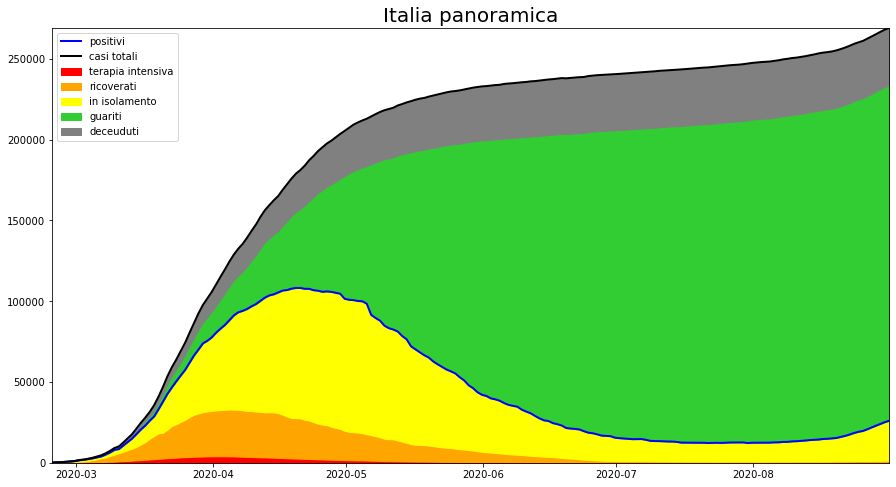

In [95]:
fig, ax = plt.subplots(figsize=(15, 8))

lo = 0
hi = italy['terapia_intensiva']
ax.fill_between(italy.index, lo, hi, color='red', label='terapia intensiva')

lo = italy['terapia_intensiva']
hi = italy['terapia_intensiva'] + italy['ricoverati_con_sintomi']
ax.fill_between(italy.index, lo, hi, color='orange', label='ricoverati')

lo = italy['terapia_intensiva'] + italy['ricoverati_con_sintomi']
hi = italy['terapia_intensiva'] + italy['ricoverati_con_sintomi'] + italy['isolamento_domiciliare']
ax.fill_between(italy.index, lo, hi, color='yellow', label='in isolamento')

ax.plot(italy.index, hi, 'b', label='positivi', lw=2)

lo = italy['terapia_intensiva'] + italy['ricoverati_con_sintomi'] + italy['isolamento_domiciliare']
hi = italy['terapia_intensiva'] + italy['ricoverati_con_sintomi'] + italy['isolamento_domiciliare'] + italy['dimessi_guariti']
ax.fill_between(italy.index, lo, hi, color='limegreen', label='guariti')

lo = italy['terapia_intensiva'] + italy['ricoverati_con_sintomi'] + italy['isolamento_domiciliare'] + italy['dimessi_guariti']
hi = italy['terapia_intensiva'] + italy['ricoverati_con_sintomi'] + italy['isolamento_domiciliare'] + italy['dimessi_guariti'] + italy['deceduti']
ax.fill_between(italy.index, lo, hi, color='grey', label='deceuduti')

ax.plot(italy.index, hi, 'k', label='casi totali', lw=2)

ax.set_xlim(italy.index[0], italy.index[-1])
ax.set_ylim(0, hi.max())

ax.set_title('Italia panoramica', fontsize=20)

plt.legend(loc='upper left')
plt.show();

In [96]:
_ = """fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(
    go.Bar(
        name="Severe", x=italy.index, y=italy["terapia_intensiva"], marker_color="red"
    ), secondary_y=False,
)
fig.add_trace(
    go.Bar(
        name="Mild", x=italy.index, y=italy["ricoverati_con_sintomi"], marker_color="orange"
    ), secondary_y=False,
)
fig.add_trace(
    go.Bar(
        name="Quarantine", x=italy.index, y=italy["isolamento_domiciliare"], marker_color="yellow"
    ), secondary_y=False,
)
fig.add_trace(
    go.Bar(
        name="Recovered", x=italy.index, y=italy["dimessi_guariti"], marker_color="lime"
    ), secondary_y=False,
)
fig.add_trace(
    go.Bar(
        name="Deaths", x=italy.index, y=italy["deceduti"], marker_color="grey"
    ), secondary_y=False,
)

fig.add_trace(
    go.Scatter(
        name="Infected", x=italy.index, y=italy["totale_positivi"], marker_color="lightskyblue", line_shape='spline',
    )
)
fig.add_trace(
    go.Scatter(
        name="Total", x=italy.index, y=italy["totale_casi"], marker_color="blue", line_shape='spline',
    ), secondary_y=False,
)

fig.update_layout(
    showlegend=True, plot_bgcolor='rgba(0,0,0,0)', 
    xaxis={"gridcolor": '#bdbdbd'},
    title={"text": "ITALY overview", "xanchor": "center", "x": 0.5},
    hovermode="x unified", barmode='stack'
)
fig.update_yaxes(title_text="number", secondary_y=False, gridcolor='#bdbdbd')
fig.update_yaxes(title_text="new/day", zerolinecolor='#969696',  secondary_y=True)

display(HTML(fig.to_html(full_html=False)))"""

# Variazioni Assolute

In [98]:
# find and fix outliers using Hampel filter
# Impl from: https://towardsdatascience.com/outlier-detection-with-hampel-filter-85ddf523c73d

def hampel_filter_pandas(input_series, window_size, n_sigmas=3.0):

    k = 1.4826 # scale factor for Gaussian distribution
    new_series = input_series.copy()

    # helper lambda function 
    MAD = lambda x: np.median(np.abs(x - np.median(x)))
    
    # the use of min_periods is to have rolling window extend towards
    # the end of the data series; in effect, we can apply hampel filter
    # to most recent observations
    # taken from: https://stackoverflow.com/questions/48953313/pandas-rolling-window-boundary-on-start-end-of-series/48953314#48953314
    rolling_window_size = 2*window_size+1
    rolling_median = input_series.rolling(
        window=rolling_window_size,
        min_periods=(rolling_window_size//2),
        center=True).median()
    rolling_mad = k * input_series.rolling(
        window=rolling_window_size,
        min_periods=(rolling_window_size//2),
        center=True).apply(MAD)
    # print(f'rolling_mad = {rolling_mad}, rolling_median = {rolling_median}')
    diff = np.abs(input_series - rolling_median)
    
    where = diff > (n_sigmas * rolling_mad)
    indices = np.argwhere(where.to_numpy()).flatten()
    new_series[indices] = rolling_median[indices]
    
    return new_series, indices

In [99]:
def hampel_filter_dataframe(dataframe, window, sigmas):
    framedict = {'data': dataframe.index}
    for col in dataframe.columns:
        filtered, _ = hampel_filter_pandas(dataframe[col], window, sigmas)
        framedict.update({col: filtered})
    newframe = pd.DataFrame(framedict)
    newframe.set_index('data', inplace=True)
    return newframe

In [100]:
filtered_italy = hampel_filter_dataframe(italy, 7, 2)

In [101]:
smoothed_italy = filtered_italy.rolling(14,
    win_type='gaussian',
    min_periods=1,
    center=True).mean(std=5).round()

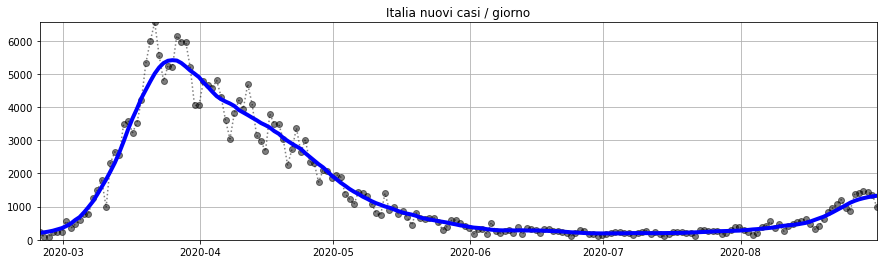

In [125]:
fig, ax = plt.subplots(figsize=(15, 4))

ax.plot(italy.index, italy['nuovi_positivi'], 'ok:', alpha=.5)
ax.plot(italy.index, smoothed_italy['nuovi_positivi'], 'b', lw=4)

ax.set_xlim(italy.index[0], italy.index[-1])
ax.set_ylim(0, italy['nuovi_positivi'].max())

ax.set_title("Italia nuovi casi / giorno")

plt.grid(axis='both')
plt.show();

In [16]:
_ = """fig = go.Figure(data=go.Scatter(
    x=italy.index, y=italy["nuovi_positivi"], 
    mode='lines+markers',
    marker_color="lightgrey", marker_size=5, marker_symbol="circle", marker_line_width=1,
    line={"dash": "dot"}, line_shape='spline',
    name="new cases/day"
))
fig.add_trace(
    go.Scatter(
        x=smoothed_italy.index, y=smoothed_italy["nuovi_positivi"],
        line_color="blue",
        legendgroup="smoothed", name="smoothed"
    )
)

fig.update_layout(legend_orientation="h",
    showlegend=True, plot_bgcolor='rgba(0,0,0,0)', 
    yaxis={"gridcolor": '#bdbdbd', "zerolinecolor": '#969696'},
    xaxis={"gridcolor": '#bdbdbd'},
    title={"text": "ITALY (new cases/day)", "xanchor": "center", "x": 0.5},
    yaxis_title="new cases/day", hovermode="x"
)

#pyo.iplot(fig)
display(HTML(fig.to_html(full_html=False)))"""

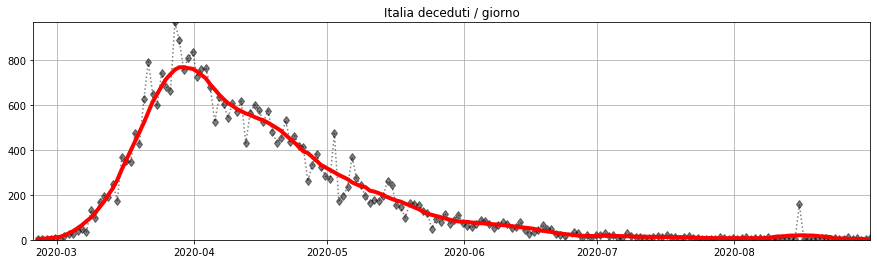

In [126]:
fig, ax = plt.subplots(figsize=(15, 4))

ax.plot(italy.index, italy['deceduti'].diff(), 'dk:', alpha=.5)
ax.plot(italy.index, smoothed_italy['deceduti'].diff(), 'r', lw=4)

ax.set_xlim(italy.index[0], italy.index[-1])
ax.set_ylim(0, italy['deceduti'].diff().max())

ax.set_title("Italia deceduti / giorno")

plt.grid(axis='both')
plt.show();

In [17]:
_ = """fig = go.Figure(data=go.Scatter(
    x=italy.index, y=italy["deceduti"].diff(), 
    mode='lines+markers',
    marker_color="grey", marker_size=5, marker_symbol="diamond", marker_line_width=1,
    line={"dash": "dot"}, line_shape='spline',
    name="new deaths/day"
))
fig.add_trace(
    go.Scatter(
        x=smoothed_italy.index, y=smoothed_italy["deceduti"].diff(),
        line_color="red",
        legendgroup="smoothed", name="smoothed"
    )
)

fig.update_layout(legend_orientation="h",
    showlegend=True, plot_bgcolor='rgba(0,0,0,0)', 
    yaxis={"gridcolor": '#bdbdbd', "zerolinecolor": '#969696'},
    xaxis={"gridcolor": '#bdbdbd'},
    title={"text": "ITALY (new deaths/day)", "xanchor": "center", "x": 0.5},
    yaxis_title="new deaths/day", hovermode="x"
)

#pyo.iplot(fig)
display(HTML(fig.to_html(full_html=False)))"""

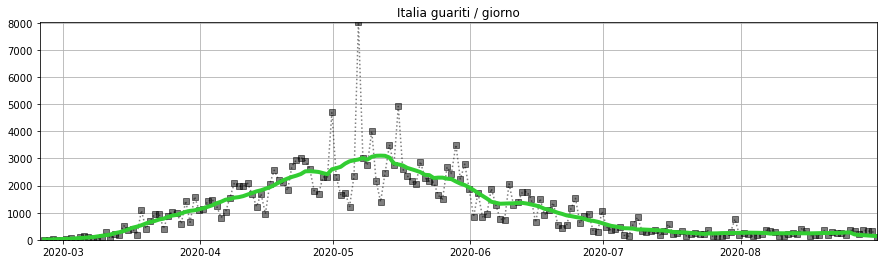

In [127]:
fig, ax = plt.subplots(figsize=(15, 4))

ax.plot(italy.index, italy['dimessi_guariti'].diff(), 'sk:', alpha=.5)
ax.plot(italy.index, smoothed_italy['dimessi_guariti'].diff(), 'limegreen', lw=4)

ax.set_xlim(italy.index[0], italy.index[-1])
ax.set_ylim(0, italy['dimessi_guariti'].diff().max())

ax.set_title("Italia guariti / giorno")

plt.grid(axis='both')
plt.show();

In [18]:
_ = """fig = go.Figure(data=go.Scatter(
    x=italy.index, y=italy["dimessi_guariti"].diff(), 
    mode='lines+markers',
    marker_color="grey", marker_size=5, marker_symbol="square", marker_line_width=1,
    line={"dash": "dot"}, line_shape='spline',
    name="new recovered/day"
))
fig.add_trace(
    go.Scatter(
        x=smoothed_italy.index, y=smoothed_italy["dimessi_guariti"].diff(),
        line_color="lime",
        legendgroup="smoothed", name="smoothed"
    )
)

fig.update_layout(legend_orientation="h",
    showlegend=True, plot_bgcolor='rgba(0,0,0,0)', 
    yaxis={"gridcolor": '#bdbdbd', "zerolinecolor": '#969696'},
    xaxis={"gridcolor": '#bdbdbd'},
    title={"text": "ITALY (new recovered/day)", "xanchor": "center", "x": 0.5},
    yaxis_title="new recovered/day", hovermode="x"
)

#pyo.iplot(fig)
display(HTML(fig.to_html(full_html=False)))"""

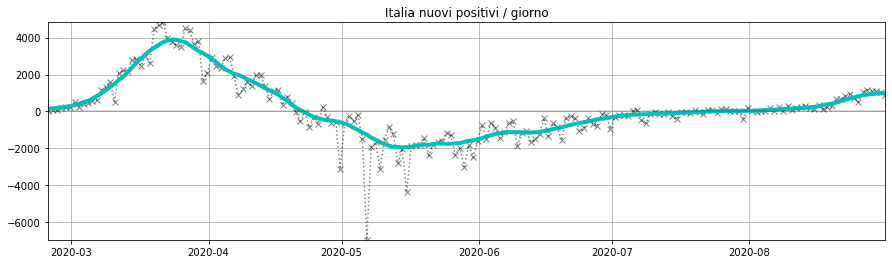

In [128]:
fig, ax = plt.subplots(figsize=(15, 4))

ax.plot(italy.index, italy['variazione_totale_positivi'], 'xk:', alpha=.5)
ax.plot(italy.index, smoothed_italy['variazione_totale_positivi'], 'c', lw=4)

ax.set_xlim(italy.index[0], italy.index[-1])
ax.set_ylim(italy['variazione_totale_positivi'].min(), italy['variazione_totale_positivi'].max())
ax.axhline(0, c='k', alpha=.2)

ax.set_title("Italia nuovi positivi / giorno")

plt.grid(axis='both')
plt.show();

In [19]:
_ = """fig = go.Figure(data=go.Scatter(
    x=italy.index, y=italy["variazione_totale_positivi"], 
    mode='lines+markers',
    marker_color="grey", marker_size=5, marker_symbol="x", marker_line_width=1,
    line={"dash": "dot"}, line_shape='spline',
    name="new infected/day"
))
fig.add_trace(
    go.Scatter(
        x=smoothed_italy.index, y=smoothed_italy["variazione_totale_positivi"],
        line_color="lightskyblue",
        legendgroup="smoothed", name="smoothed"
    )
)

fig.update_layout(legend_orientation="h",
    showlegend=True, plot_bgcolor='rgba(0,0,0,0)', 
    yaxis={"gridcolor": '#bdbdbd', "zerolinecolor": '#969696'},
    xaxis={"gridcolor": '#bdbdbd'},
    title={"text": "ITALY (new infected/day)", "xanchor": "center", "x": 0.5},
    yaxis_title="new infected/day", hovermode="x"
)

#pyo.iplot(fig)
display(HTML(fig.to_html(full_html=False)))"""

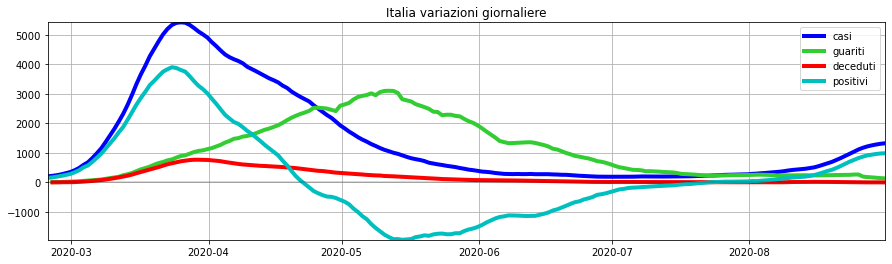

In [129]:
fig, ax = plt.subplots(figsize=(15, 4))

ax.plot(italy.index, smoothed_italy['nuovi_positivi'], 'b', lw=4, label='casi')
ax.plot(italy.index, smoothed_italy['dimessi_guariti'].diff(), 'limegreen', lw=4, label='guariti')
ax.plot(italy.index, smoothed_italy['deceduti'].diff(), 'r', lw=4, label='deceduti')
ax.plot(italy.index, smoothed_italy['variazione_totale_positivi'], 'c', lw=4, label='positivi')

ax.set_xlim(italy.index[0], italy.index[-1])
ax.set_ylim(smoothed_italy['variazione_totale_positivi'].min(), smoothed_italy['nuovi_positivi'].max())
ax.axhline(0, c='k', alpha=.2)

ax.legend(loc='upper right')

ax.set_title("Italia variazioni giornaliere")

plt.grid(axis='both')
plt.show();

In [20]:
_ = """fig = go.Figure()

# CONFIRMED
fig.add_trace(
    go.Scatter(
        x=smoothed_italy.index, y=smoothed_italy["nuovi_positivi"],
        line_color="blue",
        legendgroup="cases", name="cases"
    )
)

# DEATHS
fig.add_trace(
    go.Scatter(
        x=smoothed_italy.index, y=smoothed_italy["deceduti"].diff(),
        line_color="red",
        legendgroup="deaths", name="deaths"
    )
)

# RECOVERD
fig.add_trace(
    go.Scatter(
        x=smoothed_italy.index, y=smoothed_italy["dimessi_guariti"].diff(),
        line_color="lime",
        legendgroup="recovered", name="recovered"
    )
)

# INFECTED
fig.add_trace(
    go.Scatter(
        x=smoothed_italy.index, y=smoothed_italy["variazione_totale_positivi"],
        line_color="lightskyblue",
        legendgroup="infected", name="infected"
    )
)

fig.update_layout(legend_orientation="h",
    showlegend=True, plot_bgcolor='rgba(0,0,0,0)', 
    yaxis={"gridcolor": '#bdbdbd', "zerolinecolor": '#969696'},
    xaxis={"gridcolor": '#bdbdbd'},
    title={"text": "ITALY (new/day)", "xanchor": "center", "x": 0.5},
    yaxis_title="new/day", hovermode="x"
)

#pyo.iplot(fig)
display(HTML(fig.to_html(full_html=False)))"""

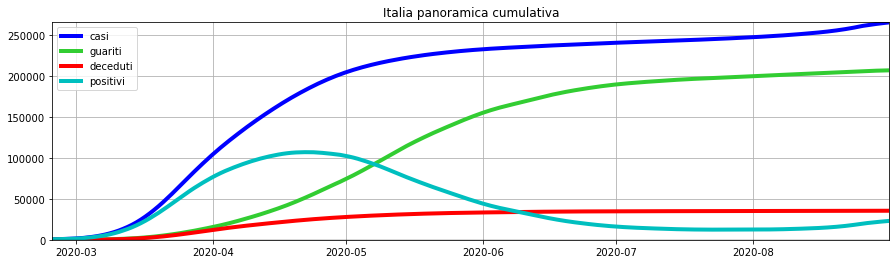

In [130]:
fig, ax = plt.subplots(figsize=(15, 4))

ax.plot(italy.index, smoothed_italy['totale_casi'], 'b', lw=4, label='casi')
ax.plot(italy.index, smoothed_italy['dimessi_guariti'], 'limegreen', lw=4, label='guariti')
ax.plot(italy.index, smoothed_italy['deceduti'], 'r', lw=4, label='deceduti')
ax.plot(italy.index, smoothed_italy['totale_positivi'], 'c', lw=4, label='positivi')

ax.set_xlim(italy.index[0], italy.index[-1])
ax.set_ylim(0, smoothed_italy['totale_casi'].max())
ax.axhline(0, c='k', alpha=.2)

ax.legend(loc='upper left')

ax.set_title("Italia panoramica cumulativa")

plt.grid(axis='both')
plt.show();

In [21]:
_ = """fig = go.Figure()

fig.add_trace(
    go.Scatter(
        x=smoothed_italy.index, y=smoothed_italy["totale_casi"],
        line_color="blue",
        name="total cases"
    )
)

fig.add_trace(
    go.Scatter(
        x=smoothed_italy.index, y=smoothed_italy["deceduti"],
        line_color="red",
        name="deaths"
    )
)

fig.add_trace(
    go.Scatter(
        x=smoothed_italy.index, y=smoothed_italy["dimessi_guariti"],
        line_color="green",
        name="recovered"
    )
)

fig.add_trace(
    go.Scatter(
        x=smoothed_italy.index, y=smoothed_italy["totale_positivi"],
        line_color="lightskyblue",
        name="infected"
    )
)

fig.update_layout(legend_orientation="h",
    showlegend=True, plot_bgcolor='rgba(0,0,0,0)', 
    yaxis={"gridcolor": '#bdbdbd', "zerolinecolor": '#969696'},
    xaxis={"gridcolor": '#bdbdbd'},
    title={"text": "ITALY (cases)", "xanchor": "center", "x": 0.5},
    yaxis_title="cases", hovermode="x"
)

#pyo.iplot(fig)
display(HTML(fig.to_html(full_html=False)))"""

***

# Variazioni percentuali

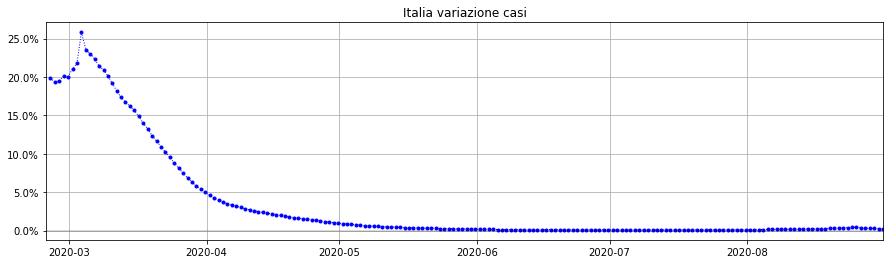

In [145]:
fig, ax = plt.subplots(figsize=(15, 4))

ax.plot(italy.index, smoothed_italy['totale_casi'].pct_change(), 'ob:', ms=3, lw=1)

ax.set_xlim(italy.index[0], italy.index[-1])

ax.axhline(0, c='k', alpha=.2)

ax.set_title("Italia variazione casi")

ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))

plt.grid(axis='both')
plt.show();

In [22]:
_ = """fig = go.Figure(data=go.Scatter(
    x=italy.index, y=italy["totale_casi"].pct_change(), 
    mode='lines+markers',
    marker_color="blue", marker_size=5, marker_symbol="circle", marker_line_width=1,
    line={"dash": "dot"}, line_shape='spline',
    name="cases"
))
fig.update_layout(legend_orientation="h",
    showlegend=True, plot_bgcolor='rgba(0,0,0,0)', 
    yaxis={"gridcolor": '#bdbdbd', "zerolinecolor": '#969696', "tickformat": '+,.2%',},
    xaxis={"gridcolor": '#bdbdbd'},
    title={"text": "ITALY percentage variation (cases)", "xanchor": "center", "x": 0.5},
    yaxis_title="cases", hovermode="x"
)

#pyo.iplot(fig)
display(HTML(fig.to_html(full_html=False)))"""

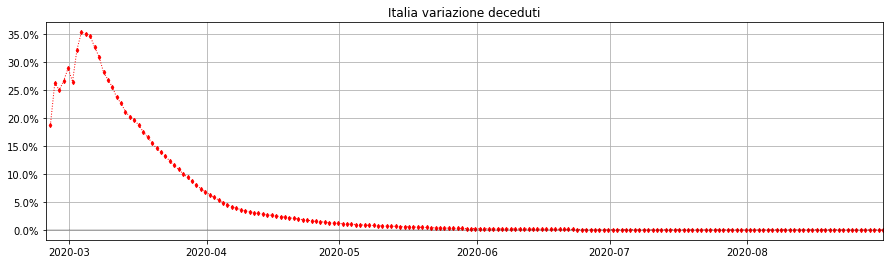

In [144]:
fig, ax = plt.subplots(figsize=(15, 4))

ax.plot(italy.index, smoothed_italy['deceduti'].pct_change(), 'dr:', ms=3, lw=1)

ax.set_xlim(italy.index[0], italy.index[-1])

ax.axhline(0, c='k', alpha=.2)

ax.set_title("Italia variazione deceduti")

ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))

plt.grid(axis='both')
plt.show();

In [23]:
_ = """fig = go.Figure(data=go.Scatter(
    x=italy.index, y=italy["deceduti"].pct_change(), 
    mode='lines+markers',
    marker_color="red", marker_size=5, marker_symbol="diamond", marker_line_width=1,
    line={"dash": "dot"}, line_shape='spline',
    name="deaths"
))
fig.update_layout(legend_orientation="h",
    showlegend=True, plot_bgcolor='rgba(0,0,0,0)', 
    yaxis={"gridcolor": '#bdbdbd', "zerolinecolor": '#969696', "tickformat": '+,.2%',},
    xaxis={"gridcolor": '#bdbdbd'},
    title={"text": "ITALY percentage variation (deaths)", "xanchor": "center", "x": 0.5},
    yaxis_title="deaths", hovermode="x"
)

#pyo.iplot(fig)
display(HTML(fig.to_html(full_html=False)))"""

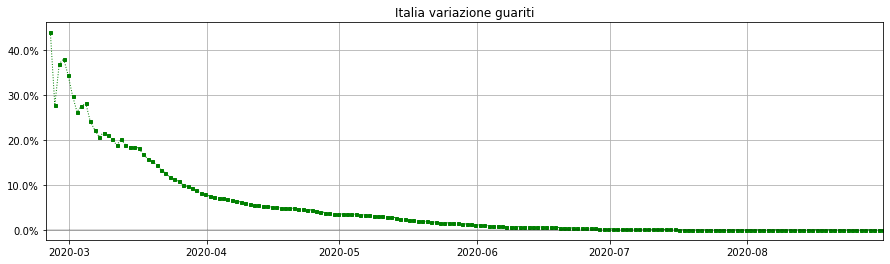

In [146]:
fig, ax = plt.subplots(figsize=(15, 4))

ax.plot(italy.index, smoothed_italy['dimessi_guariti'].pct_change(), 'sg:', ms=3, lw=1)

ax.set_xlim(italy.index[0], italy.index[-1])

ax.axhline(0, c='k', alpha=.2)

ax.set_title("Italia variazione guariti")

ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))

plt.grid(axis='both')
plt.show();

In [24]:
_ = """fig = go.Figure(data=go.Scatter(
    x=italy.index[4:], y=italy["dimessi_guariti"][4:].pct_change(), 
    mode='lines+markers',
    marker_color="lime", marker_size=5, marker_symbol="square", marker_line_width=1,
    line={"dash": "dot"}, line_shape='spline',
    name="recovered"
))
fig.update_layout(legend_orientation="h",
    showlegend=True, plot_bgcolor='rgba(0,0,0,0)', 
    yaxis={"gridcolor": '#bdbdbd', "zerolinecolor": '#969696', "tickformat": '+,.2%',},
    xaxis={"gridcolor": '#bdbdbd'},
    title={"text": "ITALY percentage variation (recovered)", "xanchor": "center", "x": 0.5},
    yaxis_title="recovered", hovermode="x"
)

#pyo.iplot(fig)
display(HTML(fig.to_html(full_html=False)))"""

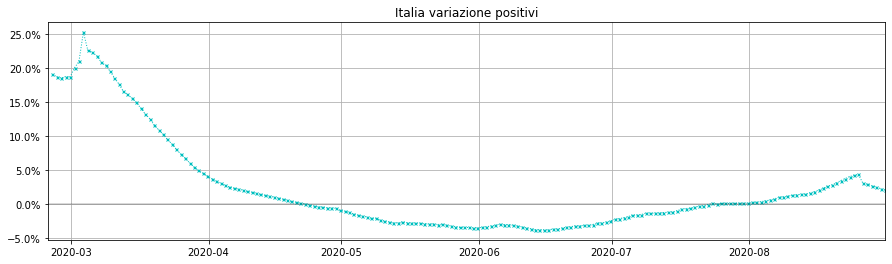

In [147]:
fig, ax = plt.subplots(figsize=(15, 4))

ax.plot(italy.index, smoothed_italy['totale_positivi'].pct_change(), 'xc:', ms=3, lw=1)

ax.set_xlim(italy.index[0], italy.index[-1])

ax.axhline(0, c='k', alpha=.2)

ax.set_title("Italia variazione positivi")

ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))

plt.grid(axis='both')
plt.show();

In [25]:
_ = """fig = go.Figure(data=go.Scatter(
    x=italy.index, y=italy["totale_positivi"].pct_change(), 
    mode='lines+markers',
    marker_color="lightskyblue", marker_size=5, marker_symbol="x", marker_line_width=1,
    line={"dash": "dot"}, line_shape='spline',
    name="infected"
))
fig.update_layout(legend_orientation="h",
    showlegend=True, plot_bgcolor='rgba(0,0,0,0)', 
    yaxis={"gridcolor": '#bdbdbd', "zerolinecolor": '#969696', "tickformat": '+,.2%',},
    xaxis={"gridcolor": '#bdbdbd'},
    title={"text": "ITALY percentage variation (infected)", "xanchor": "center", "x": 0.5},
    yaxis_title="infected", hovermode="x"
)

#pyo.iplot(fig)
display(HTML(fig.to_html(full_html=False)))"""

***

# Letalità e Guarigione

!!! PLEASE NOTE !!!

These rates are only useful for **SIRD** epidemiological model ([read here for details](https://maxpierini.it/R0.pdf)) not to define COVID-19 actual rates.

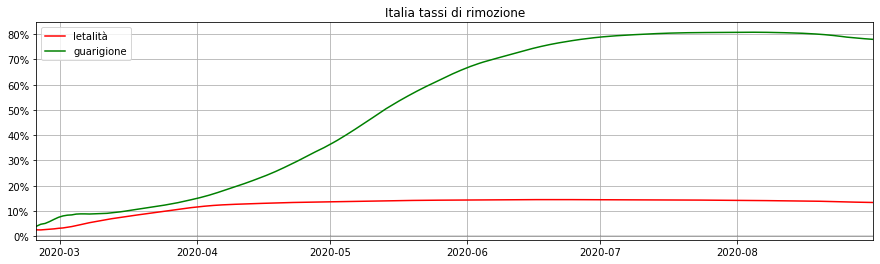

In [156]:
fig, ax = plt.subplots(figsize=(15, 4))

ax.plot(italy.index, smoothed_italy['deceduti']/smoothed_italy['totale_casi'], 'r', label='letalità')
ax.plot(italy.index, smoothed_italy['dimessi_guariti']/smoothed_italy['totale_casi'], 'g', label='guarigione')

ax.set_xlim(italy.index[0], italy.index[-1])

ax.axhline(0, c='k', alpha=.2)

ax.set_title("Italia tassi di rimozione")
ax.legend(loc='upper left')

ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))

plt.grid(axis='both')
plt.show();

In [26]:
_ = """fig = go.Figure()

fig.add_trace(go.Scatter(
    x=italy.index, y=italy["deceduti"]/italy["totale_casi"],
    mode='lines+markers',
    marker_size=3, marker_symbol="cross",
    line_shape='spline',
    name="letality rate",
    marker_color="red",
    hovertemplate="mortality rate<br>%{y:.2%}"
))

fig.add_trace(go.Scatter(
    x=italy.index, y=italy["dimessi_guariti"]/italy["totale_casi"],
    mode='lines+markers',
    marker_size=3, marker_symbol="diamond",
    line_shape='spline',
    name="recovery rate",
    marker_color="lime",
    hovertemplate="recovery rate<br>%{y:.2%}"
))

fig.update_layout(legend_orientation="h",
    showlegend=True, plot_bgcolor='rgba(0,0,0,0)', 
    yaxis={"gridcolor": '#bdbdbd', "zerolinecolor": '#969696', "tickformat": ',.0%',},
    xaxis={"gridcolor": '#bdbdbd'},
    title={"text": "ITALY rates", "xanchor": "center", "x": 0.5},
    yaxis_title="percentage", hovermode="x"
)

#pyo.iplot(fig)
display(HTML(fig.to_html(full_html=False)))"""

***

<hr>

# Ospedalizzazione e Isolamento

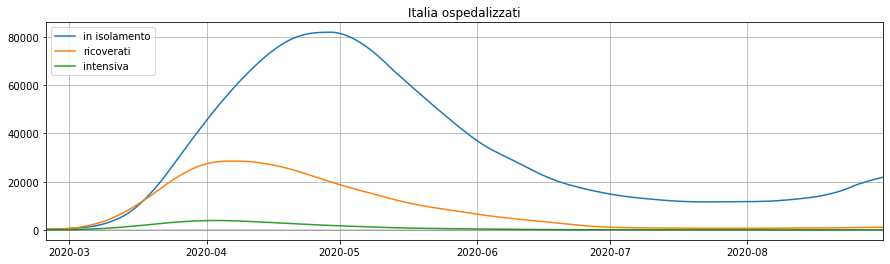

In [157]:
fig, ax = plt.subplots(figsize=(15, 4))

ax.plot(italy.index, smoothed_italy['isolamento_domiciliare'], label='in isolamento')
ax.plot(italy.index, smoothed_italy['ricoverati_con_sintomi'], label='ricoverati')
ax.plot(italy.index, smoothed_italy['terapia_intensiva'], label='intensiva')

ax.set_xlim(italy.index[0], italy.index[-1])

ax.axhline(0, c='k', alpha=.2)

ax.set_title("Italia ospedalizzati")
ax.legend(loc='upper left')

plt.grid(axis='both')
plt.show();

In [27]:
_ = """fig = go.Figure()

fig.add_trace(go.Scatter(
    x=italy.index, y=italy["ricoverati_con_sintomi"], 
    mode='lines+markers',
    marker_size=3, marker_symbol="circle",
    line_shape='spline',
    name="with symptoms"
))
fig.add_trace(go.Scatter(
    x=italy.index, y=italy["terapia_intensiva"], 
    mode='lines+markers',
    marker_size=3, marker_symbol="circle",
    line_shape='spline',
    name="emergency"
))
fig.add_trace(go.Scatter(
    x=italy.index, y=italy["isolamento_domiciliare"], 
    mode='lines+markers',
    marker_size=3, marker_symbol="circle",
    line_shape='spline',
    name="home"
))
fig.update_layout(legend_orientation="h",
    showlegend=True, plot_bgcolor='rgba(0,0,0,0)', 
    yaxis={"gridcolor": '#bdbdbd', "zerolinecolor": '#969696'},
    xaxis={"gridcolor": '#bdbdbd'},
    title={"text": "ITALY (current hospitalized)", "xanchor": "center", "x": 0.5},
    yaxis_title="number", hovermode="x"
)

#pyo.iplot(fig)
display(HTML(fig.to_html(full_html=False)))"""

# Mobilità

In [158]:
google = pd.read_csv(
    "https://www.gstatic.com/covid19/mobility/Global_Mobility_Report.csv",
    usecols=[
        "date", "country_region_code", "country_region", "sub_region_1", "sub_region_2",
        "retail_and_recreation_percent_change_from_baseline",
        "grocery_and_pharmacy_percent_change_from_baseline",
        "parks_percent_change_from_baseline",
        "transit_stations_percent_change_from_baseline",
        "workplaces_percent_change_from_baseline",
        "residential_percent_change_from_baseline"
    ],
    parse_dates=['date'], dtype={"sub_region_1": str, "sub_region_2": str},
    index_col=["date"]
)
google.to_pickle("google-mobility.pkl")
ITALY = google.loc[google["country_region_code"] == "IT"]
National = ITALY.loc[ITALY.fillna("NONE")["sub_region_1"] == "NONE"]

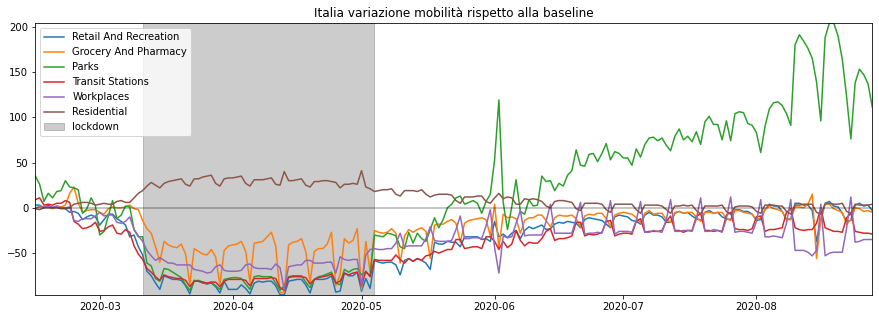

In [180]:
fig, ax = plt.subplots(figsize=(15, 5))

for column in National.columns[4:]:
    ax.plot(National[column], label=column.replace("_", " ").title().split(" Percent")[0])

ax.axhline(0, c='k', alpha=.3)
ax.fill_betweenx(
    [-500, 500], 
    pd.Timestamp("2020-03-11"), pd.Timestamp("2020-05-04"), 
    color='k', alpha=.2, label='lockdown'
)

ax.set_ylim(
    National[National.columns[4:]].values.min(),
    National[National.columns[4:]].values.max()
)
ax.set_xlim(National.index[0], National.index[-1])
ax.set_title('Italia variazione mobilità rispetto alla baseline')
ax.legend()

plt.show();

In [29]:
_ = """fig = go.Figure()
for column in National.columns[4:]:
    fig.add_trace(
        go.Scatter(
            x=National.index,
            y=National[column],
            name=column.replace("_", " ").title().split(" Percent")[0]
        )
    )
fig.add_trace(
    go.Scatter(
        x=[pd.Timestamp("2020-03-11"), pd.Timestamp("2020-03-11")], y=[-100, 100],
        showlegend=False, name="lockdown", mode="lines",
        line=dict(color='black', width=2, dash='dot'),
    )
)
fig.add_trace(
    go.Scatter(
        x=[pd.Timestamp("2020-05-04"), pd.Timestamp("2020-05-04")], y=[-100, 100],
        showlegend=False, name="1st relax", mode="lines",
        line=dict(color='black', width=2, dash='dot'),
    )
)
fig.add_trace(
    go.Scatter(
        x=[
            pd.Timestamp("2020-05-04"), pd.Timestamp("2020-05-04"), 
            pd.Timestamp("2020-03-11"), pd.Timestamp("2020-03-11")],
        y=[-100, 100, 100, -100],
        fill="toself", fillcolor="rgba(125,125,125,.05)",
        showlegend=False, name="lockdown \U00000394",
        line_color="rgba(0,0,0,0)", mode="lines+text",
        text=["Lockdown end", "Lockdown end", "Lockdown start", "Lockdown start"]
    )
)

fig.update_layout(
    legend_orientation="h",
    showlegend=True, plot_bgcolor='rgba(0,0,0,0)', 
    yaxis={"gridcolor": '#bdbdbd', "zerolinecolor": '#969696'},
    xaxis={"gridcolor": '#bdbdbd'},
    title={"text": f"Italy mobility (last update {National.index[-1].date()})", "xanchor": "center", "x": 0.5},
    yaxis_title="Percentage Change from Baseline", hovermode="x unified"
)
#pyo.iplot(fig)
display(HTML(fig.to_html(full_html=False)))"""

# R0

If the number of Infected $\mathbf{I} \ll \mathbf{N}$ total population (in the SIR model, $\mathbf{S}$usceptible $\rightarrow \mathbf{I}$nfected $ \rightarrow \mathbf{R}$emoved), the basic reproduction number $R_0$ can be calculated as

$$ R_0 \simeq \frac{\beta}{\gamma} $$

and knowing that

$$ d \mathbf{R} = \gamma \mathbf{I} $$

$$ d \mathbf{I} = (\beta - \gamma)\mathbf{I} $$

we find that

$$ \gamma =  \frac{ d \mathbf{R} }{ \mathbf{I} }$$

$$ \beta = \frac{d \mathbf{I}}{\mathbf{I}} + \gamma = \frac{d \mathbf{I} + d \mathbf{R}}{\mathbf{I}} $$

so

$$ R_0 \simeq \frac{ \frac{d \mathbf{I} + d \mathbf{R}}{\mathbf{I}} }{ \frac{ d \mathbf{R} }{ \mathbf{I} } } 
= \frac{d \mathbf{I} + d \mathbf{R}}{d \mathbf{R}} = \frac{d \mathbf{I}}{d \mathbf{R}} + 1$$

thus since

$$ d \mathbf{R} \geq 0 $$

we can say that

$$ d \mathbf{I} > 0 \Rightarrow R_0 > 1 $$

$$ d \mathbf{I} = 0 \Rightarrow R_0 = 1 $$

$$ d \mathbf{I} < 0 \Rightarrow R_0 < 1 $$

> So when the daily number of new infected is greater than zero, $R_0$ is greater than 1 and could be a sign of an out-of-control epidemy.

When calculated with simplified methods like this (and using ordinary differential equations) $R_0$ is, in fact, simply a threshold, not the average number of secondary infections and can only determine whether an epidemy will die out ($R_0 < 1$) or not ($R_0 > 1$).

***

Let's try to calculate $R_0$ for Italy, using the iterpolated and smoothed data (to smooth daily fluctuations):
- $d \mathbf{R}$ are daily variation of `Recovered` + `Deaths` data 
- $d \mathbf{I}$ is `Infected` daily variation generated by the sum of daily variation data for `Confirmed`, `Deaths` and `Recovered` 
- $\mathbf{I}$ is `Infected` curve generated by the sum of `Confirmed`, `Deaths` and `Recovered`

([read here for details](https://maxpierini.it/R0.pdf))

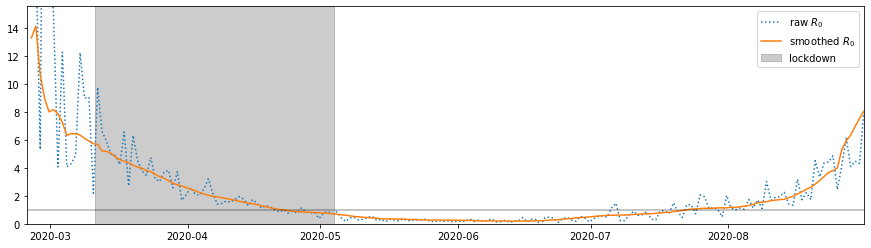

In [187]:
dI = italy["variazione_totale_positivi"]
dR = italy["dimessi_guariti"].diff()
dD = italy["deceduti"].diff()

sdI = smoothed_italy["variazione_totale_positivi"]
sdR = smoothed_italy["dimessi_guariti"].diff()
sdD = smoothed_italy["deceduti"].diff()

R0 = dI / (dR + dD) + 1
sR0 = sdI / (sdR + sdD) + 1

fig, ax = plt.subplots(figsize=(15, 4))

ax.plot(italy.index[1:], R0[1:], ':', label='raw $R_0$')
ax.plot(italy.index[1:], sR0[1:], label='smoothed $R_0$')

ax.fill_betweenx(
    [-500, 500], 
    pd.Timestamp("2020-03-11"), pd.Timestamp("2020-05-04"), 
    color='k', alpha=.2, label='lockdown'
)

ax.set_xlim(italy.index[0], italy.index[-1])
ax.set_ylim(0, sR0.max()*1.1)

ax.legend()

ax.axhline(1, c="k", alpha=.3)

plt.show();


_ = """fig = go.Figure()
fig.add_trace(
    go.Scatter(
        x=italy.index[1:],
        y=R0[1:],
        marker=dict(
            size=6,
            line=dict(width=1, color="black"),
            color=R0[1:],
            cmin=0,
            cmax=6,
            colorbar=dict(
                title="R<sub>t</sub>"
            ),
            colorscale=[
                [0., "rgba(0,150,0,1)"],
                [1./6, "rgba(255, 255, 255, 1)"],
                [1., "rgba(255,0,0,1)"],
            ]
        ),
        mode="markers+lines",
        line = dict(color='grey', width=2, dash='dot'),
        name="R<sub>0</sub>",
))

fig.add_trace(
    go.Scatter(
        x=italy.index[1:],
        y=sR0[1:],
        marker=dict(
            size=6,
            line=dict(width=1, color="black"),
            color=R0[1:],
            cmin=0,
            cmax=6,
            colorbar=dict(
                title="R<sub>t</sub>"
            ),
            colorscale=[
                [0., "rgba(0,150,0,1)"],
                [1./6, "rgba(255, 255, 255, 1)"],
                [1., "rgba(255,0,0,1)"],
            ]
        ),
        mode="lines",
        line = dict(color='blue', width=4),
        name="R<sub>0</sub> smooth",
))


fig.add_trace(
    go.Scatter(
        x=[italy.index[1], italy.index[-1]], y=[1, 1],
        #fill="tozeroy",
        #fillcolor="rgba(0, 250, 250, .15)",
        mode="lines",
        line_color="rgba(0, 0, 0, .5)",
        name="R<sub>0</sub> < 1", showlegend=False
    )
)
fig.add_trace(
    go.Scatter(
        x=[pd.Timestamp("2020-03-11"), pd.Timestamp("2020-03-11")], y=[-100, 100],
        showlegend=False, name="lockdown", mode="lines",
        line=dict(color='black', width=2, dash='dot'),
    )
)
fig.add_trace(
    go.Scatter(
        x=[pd.Timestamp("2020-05-04"), pd.Timestamp("2020-05-04")], y=[-100, 100],
        showlegend=False, name="1st relax", mode="lines",
        line=dict(color='black', width=2, dash='dot'),
    )
)
fig.add_trace(
    go.Scatter(
        x=[
            pd.Timestamp("2020-05-04"), pd.Timestamp("2020-05-04"), 
            pd.Timestamp("2020-03-11"), pd.Timestamp("2020-03-11")],
        y=[-100, 100, 100, -100],
        fill="toself", fillcolor="rgba(125,125,125,.05)",
        showlegend=False, name="lockdown \U00000394",
        line_color="rgba(0,0,0,0)", mode="lines",
    )
)

fig.update_layout(legend_orientation="h",
    showlegend=True, plot_bgcolor='rgba(0,0,0,0)', 
    yaxis={"gridcolor": '#bdbdbd', "zerolinecolor": '#969696', "range": [0, 15]},
    xaxis={"gridcolor": '#bdbdbd'},
    title={"text": "ITALY (R<sub>0</sub>)", "xanchor": "center", "x": 0.5},
    yaxis_title="$R_0$", hovermode="x unified"
)

#pyo.iplot(fig)
display(HTML(fig.to_html(full_html=False)))"""

# R<sub>t</sub> bayesiano

Italy $R_t$ (effective reproduction number in time $t$) calculated with Bayesian approach ([Bettencourt & Ribeiro 2008](https://journals.plos.org/plosone/article?id=10.1371/journal.pone.0002185) and [Kevin Systrom 2020](https://github.com/k-sys/covid-19/blob/master/Realtime%20R0.ipynb)).

The vertical dashed line is the day of the national lockdown (dashed) and first lockdown relax (dotted).

Method: [italian (PDF)](calcolo-Rt.pdf)

In [216]:
from matplotlib.colors import ListedColormap

_ = """italy = None
url = 'https://raw.githubusercontent.com/pcm-dpc/COVID-19/master/dati-andamento-nazionale/dpc-covid19-ita-andamento-nazionale.csv'
italy = pd.read_csv(url,
                     usecols=['data', 'nuovi_positivi'],
                     parse_dates=['data'],
                     index_col=['data'],
                     squeeze=True).sort_index()"""

# We create an array for every possible value of Rt
R_T_MAX = -6
R_T_MAX = 6
r_t_range = np.linspace(0, R_T_MAX, R_T_MAX*100+1)

# Gamma is 1/serial interval
# https://wwwnc.cdc.gov/eid/article/26/7/20-0282_article
# https://www.nejm.org/doi/full/10.1056/NEJMoa2001316
GAMMA = 1/7.5

def prepare_cases(cases, cutoff=1, filter_win=7, filter_std=2, smooth_win=14, smooth_std=5):

    cases[cases < 0] = 0

    cases, cases_outliers = hampel_filter_pandas(cases, filter_win, filter_std)
    
    smoothed = cases.rolling(smooth_win,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=smooth_std).round()
    smoothed[smoothed < 0] = 0
    
    idx_start = np.searchsorted(smoothed, cutoff)
    
    smoothed = smoothed.iloc[idx_start:]
    original = cases.loc[smoothed.index]
    
    return original, smoothed

def highest_density_interval(pmf, p=.95):
    # If we pass a DataFrame, just call this recursively on the columns
    if(isinstance(pmf, pd.DataFrame)):
        return pd.DataFrame([highest_density_interval(pmf[col], p=p) for col in pmf],
                            index=pmf.columns)

    cumsum = np.cumsum(pmf.values)

    # N x N matrix of total probability mass for each low, high
    total_p = cumsum - cumsum[:, None]

    # Return all indices with total_p > p
    lows, highs = np.array([]), np.array([])
    j = 0
    while not lows.size or not highs.size:
        lows, highs = (total_p > (p-j)).nonzero()
        j += .05

    try:
        # Find the smallest range (highest density)
        best = (highs - lows).argmin()
    except Exception as e:
        print("ERR {}".format(e))
        best = 0

    low = pmf.index[lows[best]]
    high = pmf.index[highs[best]]

    return pd.Series([low, high],
                     index=[f'Low_{p*100:.0f}',
                            f'High_{p*100:.0f}'])

def HDI_of_grid(probMassVec, credMass=0.95):
    sortedProbMass = np.sort(probMassVec, axis=None)[::-1]
    HDIheightIdx = np.min(np.where(np.cumsum(sortedProbMass) >= credMass))
    HDIheight = sortedProbMass[HDIheightIdx]
    HDImass = np.sum(probMassVec[probMassVec >= HDIheight])
    idx = np.where(probMassVec >= HDIheight)[0]
    return {'indexes':idx, 'mass':HDImass, 'height':HDIheight}


def HDI_of_grid_from_df(pmf, p):
    # If we pass a DataFrame, just call this recursively on the columns
    if(isinstance(pmf, pd.DataFrame)):
        return pd.DataFrame([HDI_of_grid_from_df(pmf[col], p=p) for col in pmf],
                            index=pmf.columns)
    res = HDI_of_grid(pmf, p)
    #print(res["indexes"])
    lo_idx = res["indexes"][0]
    hi_idx = res["indexes"][-1]
    
    lo = pmf.index[lo_idx]
    hi = pmf.index[hi_idx]
    
    return pd.Series([lo, hi],
                     index=[f'Low_{p*100:.0f}',
                            f'High_{p*100:.0f}'])


def HDIs(pmf, P=[.95, .5]):
    RES = []
    for p in P:
        res = HDI_of_grid_from_df(pmf, p=p)
        RES.append(res)
    return RES


def HDI_of_grid(probMassVec, credMass=0.95):
    sortedProbMass = np.sort(probMassVec, axis=None)[::-1]
    HDIheightIdx = np.min(np.where(np.cumsum(sortedProbMass) >= credMass))
    HDIheight = sortedProbMass[HDIheightIdx]
    HDImass = np.sum(probMassVec[probMassVec >= HDIheight])
    idx = np.where(probMassVec >= HDIheight)[0]
    return {'indexes':idx, 'mass':HDImass, 'height':HDIheight}


def HDI_of_grid_from_df(pmf, p):
    # If we pass a DataFrame, just call this recursively on the columns
    if(isinstance(pmf, pd.DataFrame)):
        return pd.DataFrame([HDI_of_grid_from_df(pmf[col], p=p) for col in pmf],
                            index=pmf.columns)
    res = HDI_of_grid(pmf, p)
    #print(res["indexes"])
    lo_idx = res["indexes"][0]
    hi_idx = res["indexes"][-1]
    
    lo = pmf.index[lo_idx]
    hi = pmf.index[hi_idx]
    
    return pd.Series([lo, hi],
                     index=[f'Low_{p*100:.0f}',
                            f'High_{p*100:.0f}'])

def get_posteriors(sr, sigma=0.15):

    # (1) Calculate Lambda
    lam = sr[:-1].values * np.exp(GAMMA * (r_t_range[:, None] - 1))

    
    # (2) Calculate each day's likelihood
    likelihoods = pd.DataFrame(
        data = sps.poisson.pmf(sr[1:].values, lam),
        index = r_t_range,
        columns = sr.index[1:])
    
    # (3) Create the  Matrix
    process_matrix = sps.norm(loc=r_t_range,
                              scale=sigma
                             ).pdf(r_t_range[:, None]) 

    # (3a) Normalize all rows to sum to 1
    process_matrix /= process_matrix.sum(axis=0)
    
    # (4) Calculate the initial prior
    prior0 = sps.gamma(a=4).pdf(r_t_range)
    prior0 /= prior0.sum()

    # Create a DataFrame that will hold our posteriors for each day
    # Insert our prior as the first posterior.
    posteriors = pd.DataFrame(
        index=r_t_range,
        columns=sr.index,
        data={sr.index[0]: prior0}
    )
    
    # We said we'd keep track of the sum of the log of the probability
    # of the data for maximum likelihood calculation.
    log_likelihood = 0.0

    # (5) Iteratively apply Bayes' rule
    for previous_day, current_day in zip(sr.index[:-1], sr.index[1:]):

        #(5a) Calculate the new prior
        current_prior = process_matrix @ posteriors[previous_day]
        
        #(5b) Calculate the numerator of Bayes' Rule: P(k|R_t)P(R_t)
        numerator = likelihoods[current_day] * current_prior
        
        #(5c) Calcluate the denominator of Bayes' Rule P(k)
        denominator = np.sum(numerator)
        
        # Execute full Bayes' Rule
        posteriors[current_day] = numerator/denominator
        
        # Add to the running sum of log likelihoods
        log_likelihood += np.log(denominator)
    
    return posteriors, log_likelihood


def plot_rt(result, name):
    
    fig, ax = plt.subplots(figsize=(15, 7))
    
    index = result['ML'].index.get_level_values('data')
    values = result['ML'].values
    update = result.index.get_level_values('data')[-1].date()
    
    ax.set_title(f"Italia $R_t$ metodo bayesiano, aggiornato al {update} (CIs 50%-95%)")
    
    # Colors
    ABOVE = [1,0,0]
    MIDDLE = [1,1,1]
    BELOW = [0,.75,0]
    cmap = ListedColormap(np.r_[
        np.linspace(BELOW,MIDDLE,25),
        np.linspace(MIDDLE,ABOVE,25)
    ])
    color_mapped = lambda y: np.clip(y, .5, 1.5)-.5
    
    # Plot dots and line
    ax.plot(index, values, c='k', zorder=1, alpha=.25)
    ax.scatter(index,
               values,
               s=20,
               lw=.25,
               c=cmap(color_mapped(values)),
               edgecolors='k', zorder=2)
    
    extended = pd.date_range(start=pd.Timestamp('2020-02-24'),
                         end=index[-1]+pd.Timedelta(days=1))
    
    # Aesthetically, extrapolate credible interval by 1 day either side
    lofn = interp1d(date2num(index),
                     result['Low_95'].values,
                     bounds_error=False,
                     fill_value='extrapolate')

    hifn = interp1d(date2num(index),
                      result['High_95'].values,
                      bounds_error=False,
                      fill_value='extrapolate')
    
    # Aesthetically, extrapolate credible interval by 1 day either side
    lofn50 = interp1d(date2num(index),
                     result['Low_50'].values,
                     bounds_error=False,
                     fill_value='extrapolate')

    hifn50 = interp1d(date2num(index),
                      result['High_50'].values,
                      bounds_error=False,
                      fill_value='extrapolate')

    ax.fill_between(extended,
                    lofn(date2num(extended)),
                    hifn(date2num(extended)),
                    color='k',
                    alpha=.1,
                    lw=0,
                    zorder=3)
    
    ax.fill_between(extended,
                    lofn50(date2num(extended)),
                    hifn50(date2num(extended)),
                    color='k',
                    alpha=.2,
                    lw=0,
                    zorder=4)

    ax.axhline(1.0, c='k', lw=1, label='$R_t=1.0$', alpha=.25);
    
    # Formatting
    ax.xaxis.set_major_locator(mdates.MonthLocator())
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%b'))
    ax.xaxis.set_minor_locator(mdates.DayLocator())
    
    ax.yaxis.set_major_locator(mtick.MultipleLocator(1))
    ax.yaxis.set_major_formatter(mtick.StrMethodFormatter("{x:.1f}"))
    ax.yaxis.tick_right()
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.margins(0)
    ax.grid(which='major', axis='both', c='k', alpha=.1, zorder=-2)
    ax.margins(0)
    ax.set_ylim(0.0, 5.0)
    ax.set_xlim(pd.Timestamp('2020-02-24'), result.index.get_level_values('data')[-1]+pd.Timedelta(days=1))

    fig.set_facecolor('w')
    plt.show()
    plt.close(fig='all')
    
    return values[-1], result['High_95'].values[-1], result['Low_95'].values[-1], result


def plotly_rt(result, name):
    index = result['ML'].index.get_level_values('data')
    values = result['ML'].values

    # Aesthetically, extrapolate credible interval by 1 day either side
    lofn = interp1d(date2num(index),
                     result['Low_95'].values,
                     bounds_error=False,
                     fill_value='extrapolate')

    hifn = interp1d(date2num(index),
                      result['High_95'].values,
                      bounds_error=False,
                      fill_value='extrapolate')
    
    # Aesthetically, extrapolate credible interval by 1 day either side
    lofn50 = interp1d(date2num(index),
                     result['Low_50'].values,
                     bounds_error=False,
                     fill_value='extrapolate')

    hifn50 = interp1d(date2num(index),
                      result['High_50'].values,
                      bounds_error=False,
                      fill_value='extrapolate')

    extended = pd.date_range(start=index[0], end=index[-1]+pd.Timedelta(days=1))
    hyperextended = pd.date_range(start=index[0]-pd.Timedelta(days=1), end=index[-1]+pd.Timedelta(days=2))
        
    fig = go.Figure()
    
    fig.add_trace(
        go.Scatter(
            x=[index[0]-pd.Timedelta(days=10), index[-1]+pd.Timedelta(days=10)], y=[1, 1],
            line = dict(color='black', width=1), showlegend=False,
        )
    )
    fig.add_trace(
        go.Scatter(
            x=[pd.Timestamp("2020-03-11"), pd.Timestamp("2020-03-11")], y=[-100, 100],
            showlegend=False, name="lockdown", mode="lines",
            line=dict(color='black', width=2, dash='dot'),
        )
    )
    fig.add_trace(
        go.Scatter(
            x=[pd.Timestamp("2020-05-04"), pd.Timestamp("2020-05-04")], y=[-100, 100],
            showlegend=False, name="1st relax", mode="lines",
            line=dict(color='black', width=2, dash='dot'),
        )
    )
    fig.add_trace(
        go.Scatter(
            x=[
                pd.Timestamp("2020-05-04"), pd.Timestamp("2020-05-04"), 
                pd.Timestamp("2020-03-11"), pd.Timestamp("2020-03-11")],
            y=[0, 4, 4, 0],
            fill="toself", fillcolor="rgba(125,125,125,.05)",
            showlegend=False, name="lockdown \U00000394",
            line_color="rgba(0,0,0,0)", mode="lines",
        )
    )
    fig.add_trace(
        go.Scatter(
            x=index, y=lofn50(date2num(extended)),
            line_color="rgba(0,0,0,.25)", showlegend=False,
            name="lo50 R<sub>t</sub>"
        )
    )
    fig.add_trace(
        go.Scatter(
            x=index, y=hifn50(date2num(extended)),
            line_color="rgba(0,0,0,.25)", showlegend=False,
            fill="tonexty", fillcolor="rgba(0,0,0,.1)",
            name="hi50 R<sub>t</sub>"
        )
    )
    fig.add_trace(
        go.Scatter(
            x=index, y=lofn(date2num(extended)),
            line_color="rgba(0,0,0,.1)", showlegend=False,
            name="lo95 R<sub>t</sub>"
        )
    )
    fig.add_trace(
        go.Scatter(
            x=index, y=hifn(date2num(extended)),
            line_color="rgba(0,0,0,.1)", showlegend=False,
            fill="tonexty", fillcolor="rgba(0,0,0,.1)",
            name="hi95 R<sub>t</sub>"
        )
    )
    
    fig.add_trace(
        go.Scatter(
            x=index, y=values,
            marker=dict(
                size=5,
                line=dict(width=1, color="black"),
                color=values,
                cmin=0,
                cmax=max(values),
                colorbar=dict(
                    title="R<sub>t</sub>"
                ),
                colorscale=[
                    [0., "rgba(0,150,0,1)"],
                    [1./max(values), "rgba(255, 255, 255, 1)"],
                    [1., "rgba(255,0,0,1)"],
                ]
            ),
            mode="markers+lines", showlegend=False,
            line = dict(color='grey', width=2, dash='dot'),
            name="R<sub>t</sub>",
        )
    )
    fig.update_layout(legend_orientation="h",
        showlegend=True, plot_bgcolor='rgba(0,0,0,0)', 
        yaxis={"gridcolor": '#bdbdbd', "zerolinecolor": '#969696', "range":[0, max(values)+1]},
        xaxis={"gridcolor": '#bdbdbd', "range":[hyperextended[0], hyperextended[-1]]},
        title={"text": "Real time {} R<sub>t</sub>".format(name), "xanchor": "center", "x": 0.5},
        yaxis_title="$R_t$", hovermode="x unified"
    )
    #pyo.iplot(fig)
    display(HTML(fig.to_html(full_html=False)))
    
    return values[-1], result['High_95'].values[-1], result['Low_95'].values[-1], result

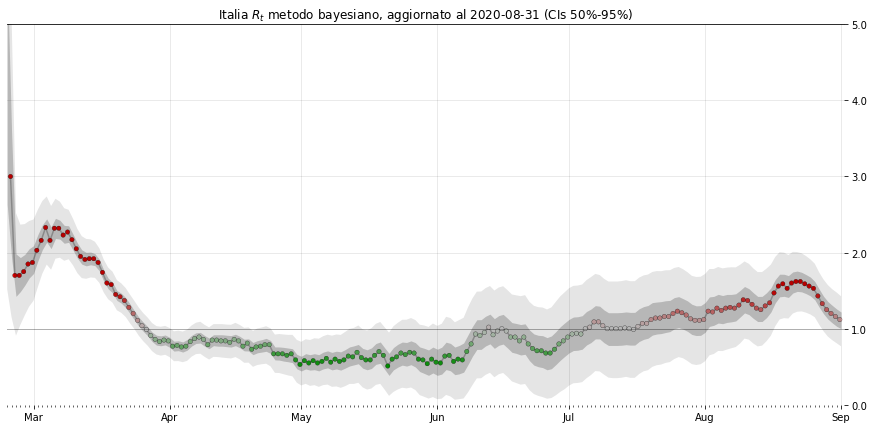

In [217]:
original, smoothed = prepare_cases(italy['nuovi_positivi'])

# Note that we're fixing sigma to a value just for the example
posteriors, log_likelihood = get_posteriors(smoothed, sigma=.25)

# Note that this takes a while to execute - it's not the most efficient algorithm
#hdis = highest_density_interval(posteriors)
HDIS = HDIs(posteriors)

most_likely = posteriors.idxmax().rename('ML')

result = most_likely
for hdis in HDIS:
    result = pd.concat([result, hdis], axis=1)

R_mean, R_max, R_min, RT = plot_rt(result, "ITALY")

__R0 = {"mean": R_mean, "max": R_max, "min": R_min}
with open("R0_italy.json", "w") as f:
    json.dump(__R0, f)

Look in [Italy Regions Overview](covid-italy-regions.html#Rt) to view $R_t$ for each region.

***

# Rt come ODDS

Effective reproduction number $R_t$ can be considered as an ODD: if for example $R_t=2$, means like in gambling that the likelihood of contagion is "given 2 to 1", so an infected will infect 2 susceptible subjects.

For the effect of the serial interval $\tau$ (onset of symptoms, diagnosis, etc), new cases $k_t$ observed in day $t$ have been infected in $t-\tau$ by the current new cases observed in $t-\tau$ (because old cases are supposed to be hospitalized, isolated, recovered or dead) so, with this simple method, in $t$ we can calculate the $R_{t-\tau}$.

$$
R_{t-\tau} = \frac{k_{t}}{k_{t-\tau}}
$$

Work in progress: distribute serial interval $\tau$ as **Gamma** and new cases $k_t$ as **Poisson**.

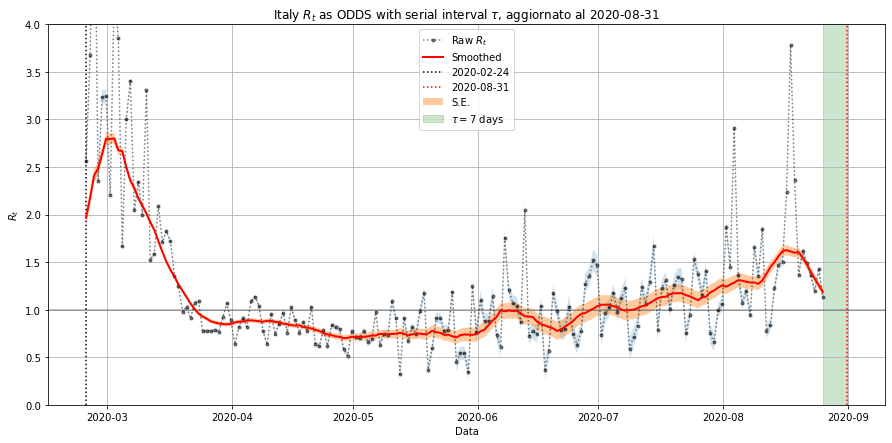

In [215]:
tau = 7

R = italy['nuovi_positivi'][tau-1:].values / italy['nuovi_positivi'][:-tau+1].values
sR = smoothed[tau-1:].values / smoothed[:-tau+1].values

ES = np.sqrt( 1/italy['nuovi_positivi'][tau-1:].values + 1/italy['nuovi_positivi'][:-tau+1].values )
sES = np.sqrt( 1/smoothed[tau-1:].values + 1/smoothed[:-tau+1].values )


fig, ax = plt.subplots(figsize=(15,7))

ax.plot(italy.index[:-tau+1], R, 'ok:', alpha=.5, ms=3, label="Raw $R_t$")
ax.fill_between(
    italy.index[:-tau+1],
    R-ES, R+ES, alpha=.2,
)

ax.plot(italy.index[:-tau+1], sR, 'r-', lw=2, zorder=10, label="Smoothed")
ax.fill_between(
    italy.index[:-tau+1],
    sR-sES, sR+sES, alpha=.4, label="S.E."
)

#ax.axhline(0, c="k", alpha=.7)
ax.axhline(1, c="k", alpha=.3)
ax.axvline(italy.index[0], c="k", ls=":", label=italy.index[0].date())
ax.fill_betweenx(
    [0, max(R)],
    italy.index[-tau], italy.index[-1],
    color="g", alpha=.2,
    label=fr"$\tau = {tau}$ days")

ax.axvline(italy.index[-1], c="r", ls=":", label=italy.index[-1].date())
ax.set_ylabel("$R_t$")
ax.set_xlabel("Data")
ax.set_ylim(0, 4)
fig.set_facecolor("w")
ax.legend()

update = result.index.get_level_values('data')[-1].date()
ax.set_title(fr"Italy $R_t$ as ODDS with serial interval $\tau$, aggiornato al {update}")
plt.grid()
plt.plot();

In [34]:
_ = """r_t_range = np.linspace(-6, 6, R_T_MAX*100+1)

# Note that we're fixing sigma to a value just for the example
posteriors, log_likelihood = get_posteriors(smoothed, sigma=.25)

# Note that this takes a while to execute - it's not the most efficient algorithm
#hdis = highest_density_interval(posteriors)
HDIS = HDIs(posteriors)

most_likely = posteriors.idxmax().rename('ML')

RT = most_likely
for hdis in HDIS:
    RT = pd.concat([RT, hdis], axis=1)

smoothed_RT = RT['ML'].rolling(8,
        win_type='gaussian',
        min_periods=1,
        center=True).mean(std=2)

SIGMA_RATE = 2

total_posteriors = {}

day = smoothed_RT.index.size-1
            
pred_RT_x = np.linspace(day, day+6, 7)
pred_RT_d = pd.date_range(RT.index[day]+pd.Timedelta(days=1), RT.index[day]+pd.Timedelta(days=7))

#print(f"RT_x: {pred_RT_x}")
#print(f"RT_d: {pred_RT_d}")

RT_diff = smoothed_RT[day-8:day].diff()[1:]
pred_RT_y = smoothed_RT.values[day] + RT_diff.values
#print(RT_diff)
#print(pred_RT_y)

#print(f"RT_y: {pred_RT_y}")

#pred_RT_y[pred_RT_y<0] = 0

Rt_scenario_lo = pred_RT_y - .5
Rt_scenario_ML = pred_RT_y
Rt_scenario_hi = pred_RT_y + .5


posteriors = {
    "lo": [],
    "ML": [],
    "hi": [],
}

k_range = np.linspace(1, 20000, 2000).astype(int)

prior0 = sps.norm(smoothed.values[day], 1).pdf(k_range)
prior0 /= prior0.sum()

Rt_scenarios = [
    Rt_scenario_lo,
    Rt_scenario_ML,
    Rt_scenario_hi
]

for Rt_val, scenario in zip(Rt_scenarios, posteriors):

    #print(f"scenario: {scenario}")
    #lam0 = italy.values[-1] * np.exp(GAMMA * (Rt_value - 1))

    #likelihood0 = sps.poisson.pmf(k_range, lam0)

    #numerator0 = prior0 * likelihood0
    #denominator0 = numerator0.sum()
    #posterior0 = prior0


    posteriors[scenario].append(prior0)

    for i in range(7):
        #print(f"pred {i}")
        Po_ML = k_range[posteriors[scenario][-1].argmax()]
        lam = Po_ML * np.exp(GAMMA * (Rt_val[i] - 1))
        likelihood = sps.poisson.pmf(k_range, lam)

        sigma = k_range[posteriors[scenario][-1].argmax()]/SIGMA_RATE
        process_matrix = sps.norm(
            loc=k_range,
            scale=sigma
        ).pdf(k_range[:,None])
        process_matrix /= process_matrix.sum(axis=0)

        prior = posteriors[scenario][-1] @ process_matrix
        numerator = prior * likelihood
        denominator = numerator.sum()
        posterior = numerator / denominator
        posteriors[scenario].append(posterior)

        #print(f"Po: {len(posteriors[scenario])}")


dates = pd.date_range(
    italy.index[day]+pd.Timedelta(days=0),
    italy.index[day]+pd.Timedelta(days=7),
)

res_lo = pd.DataFrame(index=dates, columns=["lo", "ML", "hi"])
res_ML = pd.DataFrame(index=dates, columns=["lo", "ML", "hi"])
res_hi = pd.DataFrame(index=dates, columns=["lo", "ML", "hi"])

p = .95

for i, _day in enumerate(posteriors["ML"]):
    res = HDI_of_grid(_day, p)
    lo_idx = res["indexes"][0]
    hi_idx = res["indexes"][-1]
    lo = k_range[lo_idx]
    hi = k_range[hi_idx]
    ML = k_range[_day.argmax()]
    res_ML["lo"][dates[i]] = lo
    res_ML["ML"][dates[i]] = ML
    res_ML["hi"][dates[i]] = hi

for i, _day in enumerate(posteriors["lo"]):
    res = HDI_of_grid(_day, p)
    lo_idx = res["indexes"][0]
    hi_idx = res["indexes"][-1]
    lo = k_range[lo_idx]
    hi = k_range[hi_idx]
    ML = k_range[_day.argmax()]
    res_lo["lo"][dates[i]] = lo
    res_lo["ML"][dates[i]] = ML
    res_lo["hi"][dates[i]] = hi

for i, _day in enumerate(posteriors["hi"]):
    res = HDI_of_grid(_day, p)
    lo_idx = res["indexes"][0]
    hi_idx = res["indexes"][-1]
    lo = k_range[lo_idx]
    hi = k_range[hi_idx]
    ML = k_range[_day.argmax()]
    res_hi["lo"][dates[i]] = lo
    res_hi["ML"][dates[i]] = ML
    res_hi["hi"][dates[i]] = hi

# results
fig, ax = plt.subplots(figsize=(15,7))

ax.plot(original[day-14:day+8].index, original[day-14:day+8].values, 'o:', lw=1, c="k", label="Observed")
smoothed[day-14:day+8].plot(ax=ax, lw=2, c="k", label="Observed Smoothed")

ax.plot(
    res_ML["ML"].index,
    res_ML["ML"].values,
    c="b", lw=3
)
ax.fill_between(
    res_ML["ML"].index,
    res_ML["lo"].values.astype(int),
    res_ML["hi"].values.astype(int),
    color="b", alpha=.3, label="Most Likely scenario"
)

ax.plot(
    res_lo["ML"].index,
    res_lo["ML"].values,
    c="g", ls="--", lw=3, alpha=.5
)
ax.fill_between(
    res_lo["ML"].index,
    res_ML["lo"].values.astype(int),
    res_lo["lo"].values.astype(int),
    interpolate=True,
    color="g", alpha=.2, label=r"Best scenario ($R_\tau - 0.5$)"
)

ax.plot(
    res_hi["ML"].index,
    res_hi["ML"].values,
    c="r", ls="--", lw=3, alpha=.5
)
ax.fill_between(
    res_hi["ML"].index,
    res_ML["hi"].values.astype(int),
    res_hi["hi"].values.astype(int),
    interpolate=True,
    color="r", alpha=.2, label=r"Worst scenario ($R_\tau + 0.5$)"
)

ax.axvline(original.index[day], c="k", ls="--")
ax.legend(loc="upper left")
ax.axhline(0, c="k", alpha=.3)
ax.set_ylabel("New Daily Cases")
ax.set_xlim(italy.index[day-14], res_hi.index[-1])
ax.yaxis.tick_right()

ax.xaxis.set_major_locator(mdates.WeekdayLocator())
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d %b'))
ax.xaxis.set_minor_locator(mdates.DayLocator())

ax.set_title(f"COVID-19 New Cases Prediction {res_ML['ML'].index[0]} (given estimated $R_t$)")
plt.show();"""